# Car Damage Detection
# EDA : Visualisation des données 
Omar killbi 2021-2022

---


LB consuting 

In [ ]:
# Importation des bibliothéques
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os
import re
import random
from tqdm import tqdm
import tensorflow as tf
import cv2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import array_to_img
from tensorflow.keras.preprocessing.image import img_to_array

# 1- Importation & visualisation des données 




# Data Bloc 1

---



In [ ]:
# connection avec drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
train_damaged_list = os.listdir("/content/drive/MyDrive/data_f/data1a/training/00-damage")

In [ ]:
train_not_damaged_list = os.listdir('/content/drive/MyDrive/data_f/data1a/training/01-whole')

In [ ]:
test_damaged_list = os.listdir('/content/drive/MyDrive/data_f/data1a/validation/00-damage')

In [ ]:
test_not_damaged_list = os.listdir('/content/drive/MyDrive/data_f/data1a/validation/01-whole')

In [ ]:
def plot_bar(class_labels,counts,name):
    plt.figure(figsize = (5,5))
    f = sns.barplot(x = classes,y =counts)
    plt.xlabel("Class labels", fontsize=12)
    plt.ylabel('Count', fontsize=12)
    plt.title("Number of Images in "+name+' folder', fontsize=15)
    plt.show()

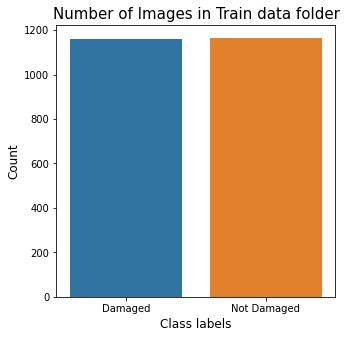

Number of Damaged images in train is 1161
Number of Not Damaged images in train is 1165


In [ ]:
classes = ['Damaged','Not Damaged']
counts = [len(train_damaged_list),len(train_not_damaged_list)]
plot_bar(classes,counts,'Train data')
for i in range(len(classes)):
    print('Number of '+classes[i]+' images in train is '+str(counts[i]))

On peut constater a partir de ce graphe que les deux classes damaged et Not Damaged sont precque egaux 
Base des données equilibrer

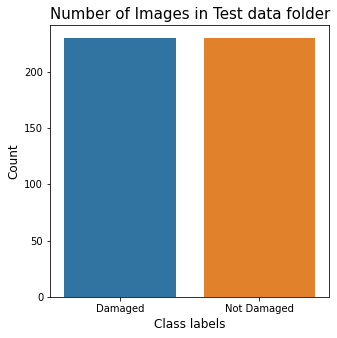

Number of Damaged images in test is 230
Number of Not Damaged images in test is 230


In [ ]:
# visualisation de test 
classes = ['Damaged','Not Damaged']
counts = [len(test_damaged_list),len(test_not_damaged_list)]
plot_bar(classes,counts,'Test data')
for i in range(len(classes)):
    print('Number of '+classes[i]+' images in test is '+str(counts[i]))

In [ ]:
def img_shapes(files,path):
    shapes = []
    for i in files:
        img = cv2.imread(path+'/'+i)
        shapes.append(img.shape)
    return shapes

In [ ]:
train_dmg = img_shapes(train_damaged_list,'/content/drive/MyDrive/data_f/data1a/training/00-damage')

In [ ]:
train_no_dmg = img_shapes(train_not_damaged_list,'/content/drive/MyDrive/data_f/data1a/training/01-whole')

In [ ]:
train_df = pd.DataFrame(list(zip(train_dmg,train_no_dmg)),columns = classes)

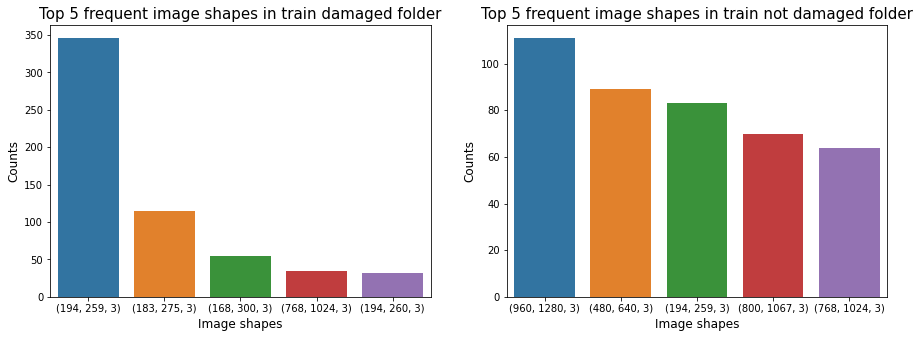

No of unique image shapes in train damaged are  212
No of unique image shapes in train not damaged are  339


In [ ]:
#Damaged train
num = [str(i) for i in train_df['Damaged'].value_counts().index[:5]]
counts_val = [i for i in train_df['Damaged'].value_counts()[:5]]
plt.figure(figsize = (15,5))
plt.subplot(1,2,1)
sns.barplot(x = num,y =counts_val)
plt.xlabel("Image shapes", fontsize=12)
plt.ylabel('Counts', fontsize=12)
plt.title("Top 5 frequent image shapes in train damaged folder", fontsize=15)

#Not Damaged train
num = [str(i) for i in train_df['Not Damaged'].value_counts().index[:5]]
counts_val = [i for i in train_df['Not Damaged'].value_counts()[:5]]
plt.subplot(1,2,2)
sns.barplot(x = num,y =counts_val)
plt.xlabel("Image shapes", fontsize=12)
plt.ylabel('Counts', fontsize=12)
plt.title("Top 5 frequent image shapes in train not damaged folder", fontsize=15)
plt.show()

print('No of unique image shapes in train damaged are ',len(train_df['Damaged'].unique()))
print('No of unique image shapes in train not damaged are ',len(train_df['Not Damaged'].unique()))

# Data Bloc 2 

---



In [ ]:
train_front = os.listdir('/content/drive/MyDrive/data_f/data2a/training/00-front')
train_rear = os.listdir('/content/drive/MyDrive/data_f/data2a/training/01-rear')
train_side = os.listdir('/content/drive/MyDrive/data_f/data2a/training/02-side')

In [ ]:
test_front = os.listdir('/content/drive/MyDrive/data_f/data2a/validation/00-front')
test_rear = os.listdir('/content/drive/MyDrive/data_f/data2a/validation/01-rear')
test_side = os.listdir('/content/drive/MyDrive/data_f/data2a/validation/02-side')

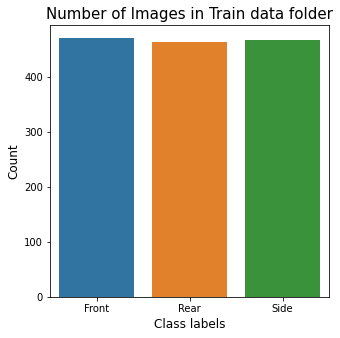

Number of Front images in train is 471
Number of Rear images in train is 464
Number of Side images in train is 468


In [ ]:
classes = ['Front','Rear','Side']
counts = [len(train_front),len(train_rear),len(train_side)]
plot_bar(classes,counts,'Train data')
for i in range(len(classes)):
    print('Number of '+classes[i]+' images in train is '+str(counts[i]))

On peut conclure a partir de ce graphe, que les 3 classes sont bien equilibreés
  

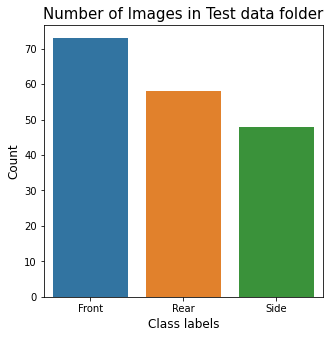

Number of Front images in test is 73
Number of Rear images in test is 58
Number of Side images in test is 48


In [ ]:
classes = ['Front','Rear','Side']
counts = [len(test_front),len(test_rear),len(test_side)]
plot_bar(classes,counts,'Test data')
for i in range(len(classes)):
    print('Number of '+classes[i]+' images in test is '+str(counts[i]))

la base de test est n'est pas equilibrer

In [ ]:
train_front_shape = img_shapes(train_front,'/content/drive/MyDrive/data_f/data2a/training/00-front')

In [ ]:
train_rear_shape = img_shapes(train_rear,'/content/drive/MyDrive/data_f/data2a/training/01-rear')

In [ ]:
train_side_shape = img_shapes(train_side,'/content/drive/MyDrive/data_f/data2a/training/02-side')

In [ ]:
train_df = pd.DataFrame(list(zip(train_front_shape,train_rear_shape,train_side_shape)),columns = classes)

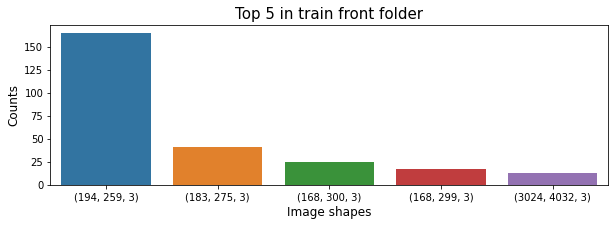

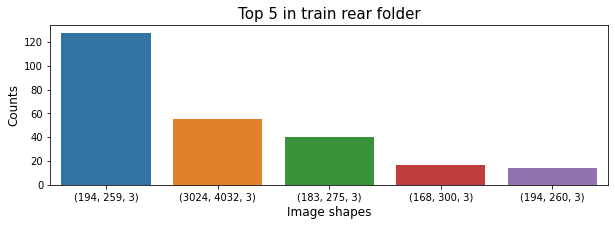

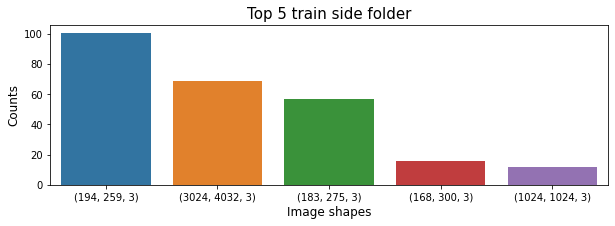

No of unique image shapes in train front are  90
No of unique image shapes in train rear are  103
No of unique image shapes in train side are  112


In [ ]:
#Front train
num = [str(i) for i in train_df['Front'].value_counts().index[:5]]
counts_val = [i for i in train_df['Front'].value_counts()[:5]]
plt.figure(figsize = (10,10))
plt.subplot(3,1,1)
sns.barplot(x = num,y =counts_val)
plt.xlabel("Image shapes", fontsize=12)
plt.ylabel('Counts', fontsize=12)
plt.title("Top 5 in train front folder", fontsize=15)

#Rear train
plt.figure(figsize = (10,10))
num = [str(i) for i in train_df['Rear'].value_counts().index[:5]]
counts_val = [i for i in train_df['Rear'].value_counts()[:5]]
plt.subplot(3,1,2)
sns.barplot(x = num,y =counts_val)
plt.xlabel("Image shapes", fontsize=12)
plt.ylabel('Counts', fontsize=12)
plt.title("Top 5 in train rear folder", fontsize=15)
plt.show()

#Side train
plt.figure(figsize = (10,10))
num = [str(i) for i in train_df['Side'].value_counts().index[:5]]
counts_val = [i for i in train_df['Side'].value_counts()[:5]]
plt.subplot(3,1,3)
sns.barplot(x = num,y =counts_val)
plt.xlabel("Image shapes", fontsize=12)
plt.ylabel('Counts', fontsize=12)
plt.title("Top 5 train side folder", fontsize=15)
plt.show()


print('No of unique image shapes in train front are ',len(train_df['Front'].unique()))
print('No of unique image shapes in train rear are ',len(train_df['Rear'].unique()))
print('No of unique image shapes in train side are ',len(train_df['Side'].unique()))

On peut constater, que la majorité des images avec la dimension (194,259,3).

# Data Bloc 3 

---



In [ ]:
train_minor = os.listdir('/content/drive/MyDrive/data_f/data3a/training/01-minor')
train_moderate = os.listdir('/content/drive/MyDrive/data_f/data3a/training/02-moderate')
train_severe = os.listdir('/content/drive/MyDrive/data_f/data3a/training/03-severe')

In [ ]:
test_minor = os.listdir('/content/drive/MyDrive/data_f/data3a/validation/01-minor')
test_moderate = os.listdir('/content/drive/MyDrive/data_f/data3a/validation/02-moderate')
test_severe = os.listdir('/content/drive/MyDrive/data_f/data3a/validation/03-severe')

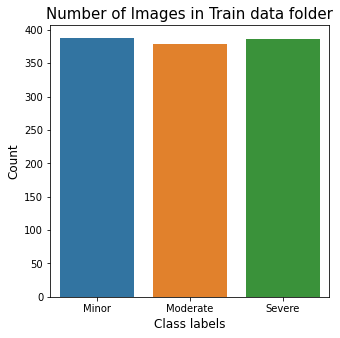

Number of Minor images in train is 388
Number of Moderate images in train is 379
Number of Severe images in train is 386


In [ ]:
classes = ['Minor','Moderate','Severe']
counts = [len(train_minor),len(train_moderate),len(train_severe)]
plot_bar(classes,counts,'Train data')
for i in range(len(classes)):
    print('Number of '+classes[i]+' images in train is '+str(counts[i]))

base equilibrer.

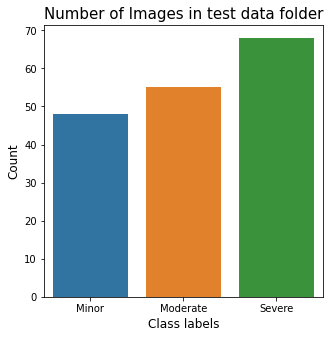

Number of Minor images in test is 48
Number of Moderate images in test is 55
Number of Severe images in test is 68


In [ ]:
classes = ['Minor','Moderate','Severe']
counts = [len(test_minor),len(test_moderate),len(test_severe)]
plot_bar(classes,counts,'test data')
for i in range(len(classes)):
    print('Number of '+classes[i]+' images in test is '+str(counts[i]))

In [ ]:
train_minor_shape = img_shapes(train_minor,'/content/drive/MyDrive/data_f/data3a/training/01-minor')

In [ ]:
train_moderate_shape = img_shapes(train_moderate,'/content/drive/MyDrive/data_f/data3a/training/02-moderate')

In [ ]:
train_severe_shape = img_shapes(train_severe,'/content/drive/MyDrive/data_f/data3a/training/03-severe')

In [ ]:
train_df = pd.DataFrame(list(zip(train_minor_shape,train_moderate_shape,train_severe_shape)),columns = classes)

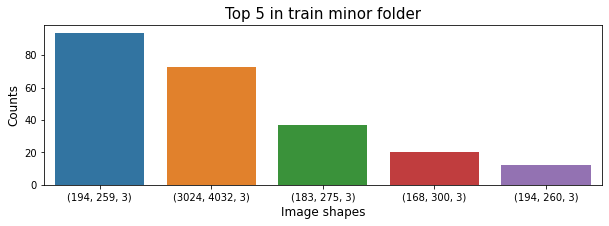

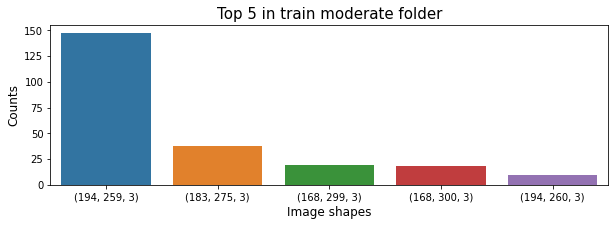

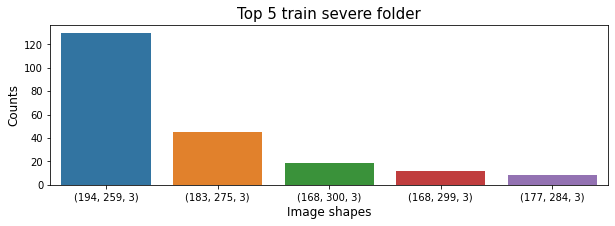

No of unique image shapes in train minor are  83
No of unique image shapes in train moderate are  83
No of unique image shapes in train severe are  81


In [ ]:
#Front train
num = [str(i) for i in train_df['Minor'].value_counts().index[:5]]
counts_val = [i for i in train_df['Minor'].value_counts()[:5]]
plt.figure(figsize = (10,10))
plt.subplot(3,1,1)
sns.barplot(x = num,y =counts_val)
plt.xlabel("Image shapes", fontsize=12)
plt.ylabel('Counts', fontsize=12)
plt.title("Top 5 in train minor folder", fontsize=15)

#Rear train
plt.figure(figsize = (10,10))
num = [str(i) for i in train_df['Moderate'].value_counts().index[:5]]
counts_val = [i for i in train_df['Moderate'].value_counts()[:5]]
plt.subplot(3,1,2)
sns.barplot(x = num,y =counts_val)
plt.xlabel("Image shapes", fontsize=12)
plt.ylabel('Counts', fontsize=12)
plt.title("Top 5 in train moderate folder", fontsize=15)
plt.show()

#Side train
plt.figure(figsize = (10,10))
num = [str(i) for i in train_df['Severe'].value_counts().index[:5]]
counts_val = [i for i in train_df['Severe'].value_counts()[:5]]
plt.subplot(3,1,3)
sns.barplot(x = num,y =counts_val)
plt.xlabel("Image shapes", fontsize=12)
plt.ylabel('Counts', fontsize=12)
plt.title("Top 5 train severe folder", fontsize=15)
plt.show()


print('No of unique image shapes in train minor are ',len(train_df['Minor'].unique()))
print('No of unique image shapes in train moderate are ',len(train_df['Moderate'].unique()))
print('No of unique image shapes in train severe are ',len(train_df['Severe'].unique()))

# Données sans Augmentation

In [ ]:
lists = [['damaged','not_damaged'],['front','rear','side'],['minor','moderate','severe']]

In [ ]:
data = ['data_1','data_2','data_3']

In [ ]:
paths = []
def create_folders(name,class_lists,data):
    os.mkdir(name)
    for i in range(3):
        os.mkdir(name+'/'+data[i])
        for j in ['train','test']:
            temp_paths = []
            os.mkdir(name+'/'+data[i]+'/'+j)
            for k in class_lists[i]:
                os.mkdir(name+'/'+data[i]+'/'+j+'/'+k)
                temp_paths.append(name+'/'+data[i]+'/'+j+'/'+k)
            paths.append(temp_paths)
create_folders('data',lists,data)

In [ ]:
#Saving images
def save_images(name,save_path,image_path):
    
    #Reading the image from given path.
    image_org = image.load_img(image_path+'/'+name)
    
    #Saving original image to folder.
    image_org.save(save_path+'/'+name)

# Data Bloc 1

---



In [ ]:
train_save_path_1 = paths[0][0]
train_save_path_2 = paths[0][1]
test_save_path_1 = paths[1][0]
test_save_path_2 = paths[1][1]
print(train_save_path_1)
print(train_save_path_2)
print(test_save_path_1)
print(test_save_path_2)

data/data_1/train/damaged
data/data_1/train/not_damaged
data/data_1/test/damaged
data/data_1/test/not_damaged


In [ ]:
for i in tqdm(train_damaged_list):
    save_images(i,train_save_path_1,'/content/drive/MyDrive/data_f/data1a/training/00-damage')

100%|██████████| 1161/1161 [00:19<00:00, 59.10it/s] 


In [ ]:
for i in tqdm(train_not_damaged_list):
    save_images(i,train_save_path_2,'/content/drive/MyDrive/data_f/data1a/training/01-whole')

100%|██████████| 1165/1165 [00:47<00:00, 24.63it/s]


In [ ]:
for i in tqdm(test_damaged_list):
    save_images(i,test_save_path_1,'/content/drive/MyDrive/data_f/data1a/validation/00-damage')

100%|██████████| 230/230 [00:46<00:00,  5.00it/s]


In [ ]:
for i in tqdm(test_not_damaged_list):
    save_images(i,test_save_path_2,'/content/drive/MyDrive/data_f/data1a/validation/01-whole')

100%|██████████| 230/230 [01:04<00:00,  3.54it/s]


# Data bloc 2 

---



In [ ]:
train_save_path_1 = paths[2][0]
train_save_path_2 = paths[2][1]
train_save_path_3 = paths[2][2]
test_save_path_1 = paths[3][0]
test_save_path_2 = paths[3][1]
test_save_path_3 = paths[3][2]
print(train_save_path_1)
print(train_save_path_2)
print(train_save_path_3)
print(test_save_path_1)
print(test_save_path_2)
print(test_save_path_3)

data/data_2/train/front
data/data_2/train/rear
data/data_2/train/side
data/data_2/test/front
data/data_2/test/rear
data/data_2/test/side


In [ ]:
for i in tqdm(train_front):
    save_images(i,train_save_path_1,'/content/drive/MyDrive/data_f/data2a/training/00-front')

100%|██████████| 471/471 [00:14<00:00, 32.88it/s]


In [ ]:
for i in tqdm(train_rear):
    save_images(i,train_save_path_2,'/content/drive/MyDrive/data_f/data2a/training/01-rear')

100%|██████████| 464/464 [00:37<00:00, 12.48it/s]


In [ ]:
for i in tqdm(train_side):
    save_images(i,train_save_path_3,'/content/drive/MyDrive/data_f/data2a/training/02-side')

100%|██████████| 468/468 [00:48<00:00,  9.74it/s]


In [ ]:
for i in tqdm(test_front):
    save_images(i,test_save_path_1,'/content/drive/MyDrive/data_f/data2a/validation/00-front')

100%|██████████| 73/73 [00:15<00:00,  4.71it/s]


In [ ]:
for i in tqdm(test_rear):
    save_images(i,test_save_path_2,'/content/drive/MyDrive/data_f/data2a/validation/01-rear')

100%|██████████| 58/58 [00:11<00:00,  4.89it/s]


In [ ]:
for i in tqdm(test_side):
    save_images(i,test_save_path_3,'/content/drive/MyDrive/data_f/data2a/validation/02-side')

100%|██████████| 48/48 [00:09<00:00,  5.18it/s]


# Data Bloc 3 

---



In [ ]:
train_save_path_1 = paths[4][0]
train_save_path_2 = paths[4][1]
train_save_path_3 = paths[4][2]
test_save_path_1 = paths[5][0]
test_save_path_2 = paths[5][1]
test_save_path_3 = paths[5][2]
print(train_save_path_1)
print(train_save_path_2)
print(train_save_path_3)
print(test_save_path_1)
print(test_save_path_2)
print(test_save_path_3)

data/data_3/train/minor
data/data_3/train/moderate
data/data_3/train/severe
data/data_3/test/minor
data/data_3/test/moderate
data/data_3/test/severe


In [ ]:
for i in tqdm(train_minor):
    save_images(i,train_save_path_1,'/content/drive/MyDrive/data_f/data3a/training/01-minor')

100%|██████████| 388/388 [00:52<00:00,  7.40it/s]


In [ ]:
for i in tqdm(train_moderate):
    save_images(i,train_save_path_2,'/content/drive/MyDrive/data_f/data3a/training/02-moderate')

100%|██████████| 379/379 [00:04<00:00, 91.98it/s]


In [ ]:
for i in tqdm(train_severe):
    save_images(i,train_save_path_3,'/content/drive/MyDrive/data_f/data3a/training/03-severe')

100%|██████████| 386/386 [00:02<00:00, 178.57it/s]


In [ ]:
for i in tqdm(test_minor):
    save_images(i,test_save_path_1,'/content/drive/MyDrive/data_f/data3a/validation/01-minor')

100%|██████████| 48/48 [00:09<00:00,  4.83it/s]


In [ ]:
for i in tqdm(test_moderate):
    save_images(i,test_save_path_2,'/content/drive/MyDrive/data_f/data3a/validation/02-moderate')

100%|██████████| 55/55 [00:10<00:00,  5.21it/s]


In [ ]:
for i in tqdm(test_severe):
    save_images(i,test_save_path_3,'/content/drive/MyDrive/data_f/data3a/validation/03-severe')

100%|██████████| 68/68 [00:14<00:00,  4.85it/s]


# Augmentation des données 

---






> Les Techniques d'augmentation 


*   Augmentation avec rotation entre 20 et -20. 
*   Augmentation avec rotation entre 20 et -20 et avec un zoom.





1.   Augmentation avec technique 1



In [ ]:
lists = [['damaged','not_damaged'],['front','rear','side'],['minor','moderate','severe']]

In [ ]:
data = ['data_1','data_2','data_3']

In [ ]:
paths = []
def create_folders(name,class_lists,data):
    os.mkdir(name)
    for i in range(3):
        os.mkdir(name+'/'+data[i])
        for j in ['train','test']:
            temp_paths = []
            os.mkdir(name+'/'+data[i]+'/'+j)
            for k in class_lists[i]:
                os.mkdir(name+'/'+data[i]+'/'+j+'/'+k)
                temp_paths.append(name+'/'+data[i]+'/'+j+'/'+k)
            paths.append(temp_paths)
create_folders('data_augmentation_1',lists,data)

# Data Bloc 1 

Visualisation d'un exemple 

---



In [ ]:
#Getting a sample file name from list of file names
sample_file = random.choice(train_damaged_list)

In [ ]:
#Getting a random rotation between -20 and 20
rotation = random.randint(-20,20)

In [ ]:
augmentation = ImageDataGenerator(rotation_range=rotation,horizontal_flip=True)

In [ ]:
sample_img = image.load_img('/content/drive/MyDrive/data_f/data1a/training/00-damage'+'/'+sample_file)

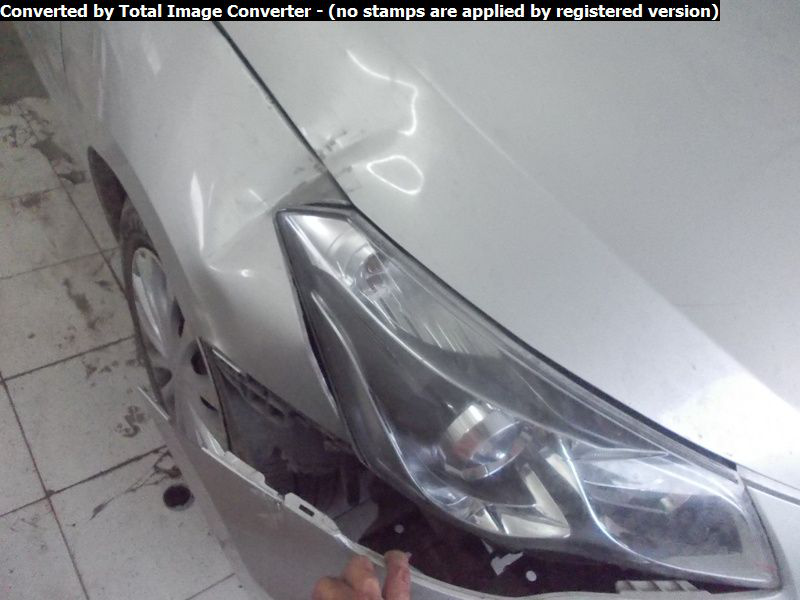

In [ ]:
sample_img

In [ ]:
sample_img_array = image.img_to_array(sample_img)

In [ ]:
sample_img_array = sample_img_array.reshape((1,) + sample_img_array.shape)

In [ ]:
samples = []
for arr,val in zip(augmentation.flow(sample_img_array, batch_size=1, save_format='jpg'),range(1)):
    img_save = image.array_to_img(arr[0], scale=False)
    samples.append(img_save)

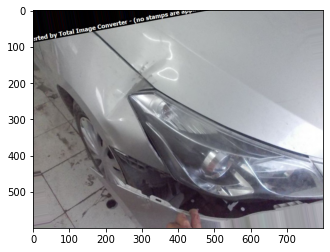

In [ ]:
plt.imshow(samples[0])



2.   generer et enregistrer des images ( train ), pour le test on fait pas une augmentation. 

In [ ]:
train_save_path_1 = paths[0][0]
train_save_path_2 = paths[0][1]
test_save_path_1 = paths[1][0]
test_save_path_2 = paths[1][1]
print(train_save_path_1)
print(train_save_path_2)
print(test_save_path_1)
print(test_save_path_2)

data_augmentation_1/data_1/train/damaged
data_augmentation_1/data_1/train/not_damaged
data_augmentation_1/data_1/test/damaged
data_augmentation_1/data_1/test/not_damaged


In [ ]:
#Creating a function to create images
def create_images(name,save_path,image_path):
    #Generating a random number for rotation
    rotation = random.randint(-20,20)
    #Creating Image Data Generator:
    augmentation = ImageDataGenerator(rotation_range=rotation,horizontal_flip=True)
    
    #Reading the image from given path.
    image_org = image.load_img(image_path+'/'+name)
    
    #Saving original image to folder.
    image_org.save(save_path+'/'+name)
    
    #Getting the numpy array of image.
    image_arr = image.img_to_array(image_org)
    
    #Expanding dimensions of image array
    image_arr = image_arr.reshape((1,) + image_arr.shape)
    
    #Using Flow to generate 2 new images for single image
    for arr,val in zip(augmentation.flow(image_arr, batch_size=1, save_format='jpeg'),range(1)):
        name = name.split('.')[0]
        img_save = image.array_to_img(arr[0], scale=False)
        img_save.save(save_path+'/'+name+'_aug_'+str(val)+'.jpeg')
    return paths

In [ ]:
#Saving images
def save_images(name,save_path,image_path):
    
    #Reading the image from given path.
    image_org = image.load_img(image_path+'/'+name)
    
    #Saving original image to folder.
    image_org.save(save_path+'/'+name)

In [ ]:
for i in tqdm(train_damaged_list):
    create_images(i,train_save_path_1,'/content/drive/MyDrive/data_f/data1a/training/00-damage')

100%|██████████| 1161/1161 [03:06<00:00,  6.21it/s]


In [ ]:
for i in tqdm(train_not_damaged_list):
    create_images(i,train_save_path_2,'/content/drive/MyDrive/data_f/data1a/training/01-whole')

100%|██████████| 1165/1165 [08:04<00:00,  2.41it/s]


In [ ]:
for i in tqdm(test_damaged_list):
    save_images(i,test_save_path_1,'/content/drive/MyDrive/data_f/data1a/validation/00-damage')

100%|██████████| 230/230 [00:01<00:00, 176.27it/s]


In [ ]:
for i in tqdm(test_not_damaged_list):
    save_images(i,test_save_path_2,'/content/drive/MyDrive/data_f/data1a/validation/01-whole')

100%|██████████| 230/230 [00:05<00:00, 39.65it/s]


# Data Bloc 2

In [ ]:
#Getting a sample file name from list of file names
sample_file = random.choice(train_front)

In [ ]:
#Getting a random rotation between -20 and 20
rotation = random.randint(-20,20)

In [ ]:
augmentation = ImageDataGenerator(rotation_range=rotation,horizontal_flip=True)

In [ ]:
sample_img = image.load_img('/content/drive/MyDrive/data_f/data2a/training/00-front'+'/'+sample_file)

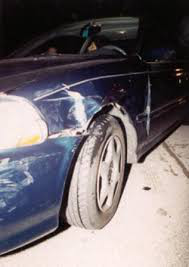

In [ ]:
sample_img

In [ ]:
sample_img_array = image.img_to_array(sample_img)

In [ ]:
sample_img_array = sample_img_array.reshape((1,) + sample_img_array.shape)

In [ ]:
samples = []
for arr,val in zip(augmentation.flow(sample_img_array, batch_size=1, save_format='jpg'),range(1)):
    img_save = image.array_to_img(arr[0], scale=False) #scale=False did the trick
    samples.append(img_save)

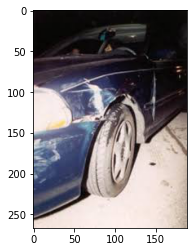

In [ ]:
plt.imshow(samples[0])

In [ ]:
train_save_path_1 = paths[2][0]
train_save_path_2 = paths[2][1]
train_save_path_3 = paths[2][2]
test_save_path_1 = paths[3][0]
test_save_path_2 = paths[3][1]
test_save_path_3 = paths[3][2]
print(train_save_path_1)
print(train_save_path_2)
print(train_save_path_3)
print(test_save_path_1)
print(test_save_path_2)
print(test_save_path_3)

data_augmentation_1/data_2/train/front
data_augmentation_1/data_2/train/rear
data_augmentation_1/data_2/train/side
data_augmentation_1/data_2/test/front
data_augmentation_1/data_2/test/rear
data_augmentation_1/data_2/test/side


In [ ]:
for i in tqdm(train_front):
    create_images(i,train_save_path_1,'/content/drive/MyDrive/data_f/data2a/training/00-front')

100%|██████████| 471/471 [02:46<00:00,  2.83it/s]


In [ ]:
for i in tqdm(train_rear):
    create_images(i,train_save_path_2,'/content/drive/MyDrive/data_f/data2a/training/01-rear')

100%|██████████| 464/464 [07:23<00:00,  1.05it/s]


In [ ]:
for i in tqdm(train_side):
    create_images(i,train_save_path_3,'/content/drive/MyDrive/data_f/data2a/training/02-side')

100%|██████████| 468/468 [10:03<00:00,  1.29s/it]


In [ ]:
for i in tqdm(test_front):
    save_images(i,test_save_path_1,'/content/drive/MyDrive/data_f/data2a/validation/00-front')

100%|██████████| 73/73 [00:00<00:00, 143.92it/s]


In [ ]:
for i in tqdm(test_rear):
    save_images(i,test_save_path_2,'/content/drive/MyDrive/data_f/data2a/validation/01-rear')

100%|██████████| 58/58 [00:00<00:00, 150.79it/s]


In [ ]:
for i in tqdm(test_side):
    save_images(i,test_save_path_3,'/content/drive/MyDrive/data_f/data2a/validation/02-side')

100%|██████████| 48/48 [00:00<00:00, 159.68it/s]


# Data Bloc 3 

In [ ]:
#Getting a sample file name from list of file names
sample_file = random.choice(train_severe)

In [ ]:
#Getting a random rotation between -20 and 20
rotation = random.randint(-20,20)

In [ ]:
augmentation = ImageDataGenerator(rotation_range=rotation,horizontal_flip=True)

In [ ]:
sample_img = image.load_img('/content/drive/MyDrive/data_f/data3a/training/03-severe'+'/'+sample_file)

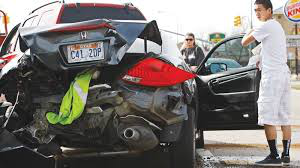

In [ ]:
sample_img

In [ ]:
sample_img_array = image.img_to_array(sample_img)

In [ ]:
sample_img_array = sample_img_array.reshape((1,) + sample_img_array.shape)

In [ ]:
samples = []
for arr,val in zip(augmentation.flow(sample_img_array, batch_size=1, save_format='jpg'),range(1)):
    img_save = image.array_to_img(arr[0], scale=False) #scale=False did the trick
    samples.append(img_save)

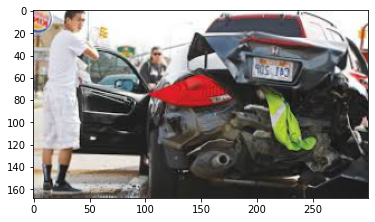

In [ ]:
plt.imshow(samples[0])

In [ ]:
train_save_path_1 = paths[4][0]
train_save_path_2 = paths[4][1]
train_save_path_3 = paths[4][2]
test_save_path_1 = paths[5][0]
test_save_path_2 = paths[5][1]
test_save_path_3 = paths[5][2]
print(train_save_path_1)
print(train_save_path_2)
print(train_save_path_3)
print(test_save_path_1)
print(test_save_path_2)
print(test_save_path_3)

data_augmentation_1/data_3/train/minor
data_augmentation_1/data_3/train/moderate
data_augmentation_1/data_3/train/severe
data_augmentation_1/data_3/test/minor
data_augmentation_1/data_3/test/moderate
data_augmentation_1/data_3/test/severe


In [ ]:
for i in tqdm(train_minor):
    create_images(i,train_save_path_1,'/content/drive/MyDrive/data_f/data3a/training/01-minor')

100%|██████████| 388/388 [10:34<00:00,  1.64s/it]


In [ ]:
for i in tqdm(train_moderate):
    create_images(i,train_save_path_2,'/content/drive/MyDrive/data_f/data3a/training/02-moderate')

100%|██████████| 379/379 [00:34<00:00, 10.89it/s]


In [ ]:
for i in tqdm(train_severe):
    create_images(i,train_save_path_3,'/content/drive/MyDrive/data_f/data3a/training/03-severe')

100%|██████████| 386/386 [00:13<00:00, 28.84it/s]


In [ ]:
for i in tqdm(test_minor):
    save_images(i,test_save_path_1,'/content/drive/MyDrive/data_f/data3a/validation/01-minor')

100%|██████████| 48/48 [00:00<00:00, 199.72it/s]


In [ ]:
for i in tqdm(test_moderate):
    save_images(i,test_save_path_2,'/content/drive/MyDrive/data_f/data3a/validation/02-moderate')

100%|██████████| 55/55 [00:00<00:00, 182.38it/s]


In [ ]:
for i in tqdm(test_severe):
    save_images(i,test_save_path_3,'/content/drive/MyDrive/data_f/data3a/validation/03-severe')

100%|██████████| 68/68 [00:00<00:00, 150.55it/s]


Resumé

In [ ]:
data_2_files = len(os.listdir('data_augmentation_1/data_2/train/front'))+len(os.listdir('data_augmentation_1/data_2/train/rear'))+len(os.listdir('data_augmentation_1/data_2/train/side'))

In [ ]:
print('Number of files for all classes front,rear,side is ',data_2_files)

Number of files for all classes front,rear,side is  2724


In [ ]:
data_3_files = len(os.listdir('data_augmentation_1/data_3/train/minor'))+len(os.listdir('data_augmentation_1/data_3/train/moderate'))+len(os.listdir('data_augmentation_1/data_3/train/severe'))

In [ ]:
print('Number of files for all classes minor,moderate,severe is ',data_3_files)

Number of files for all classes minor,moderate,severe is  2288


# Data Augmentation 2 

Paramétre

In [ ]:
lists = [['damaged','not_damaged'],['front','rear','side'],['minor','moderate','severe']]

In [ ]:
data = ['data_1','data_2','data_3']

In [ ]:
paths = []
def create_folders(name,class_lists,data):
    os.mkdir(name)
    for i in range(3):
        os.mkdir(name+'/'+data[i])
        for j in ['train','test']:
            temp_paths = []
            os.mkdir(name+'/'+data[i]+'/'+j)
            for k in class_lists[i]:
                os.mkdir(name+'/'+data[i]+'/'+j+'/'+k)
                temp_paths.append(name+'/'+data[i]+'/'+j+'/'+k)
            paths.append(temp_paths)
create_folders('data_augmentation_2',lists,data)

# Data  Bloc 1

In [ ]:
#Getting a sample file name from list of file names
sample_file = random.choice(train_damaged_list)

In [ ]:
#Getting a random rotation between -20 and 20
rotation = random.randint(-20,20)

In [ ]:
augmentation = ImageDataGenerator(rotation_range=rotation, shear_range = 0.2, zoom_range = 0.2, horizontal_flip=True)

In [ ]:
sample_img = image.load_img('/content/drive/MyDrive/data_f/data1a/training/00-damage'+'/'+sample_file)

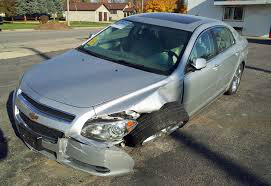

In [ ]:
sample_img

In [ ]:
sample_img_array = image.img_to_array(sample_img)

In [ ]:
sample_img_array = sample_img_array.reshape((1,) + sample_img_array.shape)

In [ ]:
amples = []
for arr,val in zip(augmentation.flow(sample_img_array, batch_size=1, save_format='jpg'),range(1)):
    img_save = image.array_to_img(arr[0], scale=False) #scale=False did the trick
    samples.append(img_save)

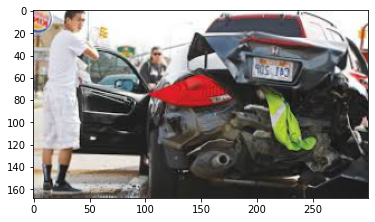

In [ ]:
plt.imshow(samples[0])

In [ ]:
train_save_path_1 = paths[0][0]
train_save_path_2 = paths[0][1]
test_save_path_1 = paths[1][0]
test_save_path_2 = paths[1][1]
print(train_save_path_1)
print(train_save_path_2)
print(test_save_path_1)
print(test_save_path_2)

data_augmentation_2/data_1/train/damaged
data_augmentation_2/data_1/train/not_damaged
data_augmentation_2/data_1/test/damaged
data_augmentation_2/data_1/test/not_damaged


In [ ]:
#Creating a function to create images
def create_images(name,save_path,image_path):
    #Generating a random number for rotation
    rotation = random.randint(-20,20)
    #Creating Image Data Generator:
    augmentation = ImageDataGenerator(rotation_range=rotation, shear_range = 0.2, zoom_range = 0.2, horizontal_flip=True)
    
    #Reading the image from given path.
    image_org = image.load_img(image_path+'/'+name)
    
    #Saving original image to folder.
    image_org.save(save_path+'/'+name)
    
    #Getting the numpy array of image.
    image_arr = image.img_to_array(image_org)
    
    #Expanding dimensions of image array
    image_arr = image_arr.reshape((1,) + image_arr.shape)
    
    #Using Flow to generate 4 new images for single image
    for arr,val in zip(augmentation.flow(image_arr, batch_size=1, save_format='jpeg'),range(1)):
        name = name.split('.')[0]
        img_save = image.array_to_img(arr[0], scale=False)
        img_save.save(save_path+'/'+name+'_aug_'+str(val)+'.jpeg')
    return paths

In [ ]:
#Saving images
def save_images(name,save_path,image_path):
    
    #Reading the image from given path.
    image_org = image.load_img(image_path+'/'+name)
    
    #Saving original image to folder.
    image_org.save(save_path+'/'+name)

In [ ]:
for i in tqdm(train_damaged_list):
    create_images(i,train_save_path_1,'/content/drive/MyDrive/data_f/data1a/training/00-damage')

100%|██████████| 1161/1161 [03:13<00:00,  5.99it/s]


In [ ]:
for i in tqdm(train_not_damaged_list):
    create_images(i,train_save_path_2,'/content/drive/MyDrive/data_f/data1a/training/01-whole')

100%|██████████| 1165/1165 [07:59<00:00,  2.43it/s]


In [ ]:
for i in tqdm(test_damaged_list):
    save_images(i,test_save_path_1,'/content/drive/MyDrive/data_f/data1a/validation/00-damage')

100%|██████████| 230/230 [00:01<00:00, 150.94it/s]


In [ ]:
for i in tqdm(test_not_damaged_list):
    save_images(i,test_save_path_2,'/content/drive/MyDrive/data_f/data1a/validation/01-whole')

100%|██████████| 230/230 [00:06<00:00, 37.44it/s]


# Data Bloc 2

In [ ]:
#Getting a sample file name from list of file names
sample_file = random.choice(train_front)

In [ ]:
#Getting a random rotation between -20 and 20
rotation = random.randint(-20,20)

In [ ]:
augmentation = ImageDataGenerator(rotation_range=rotation, shear_range = 0.2, zoom_range = 0.2, horizontal_flip=True)

In [ ]:
sample_img = image.load_img('/content/drive/MyDrive/data_f/data2a/training/00-front'+'/'+sample_file)

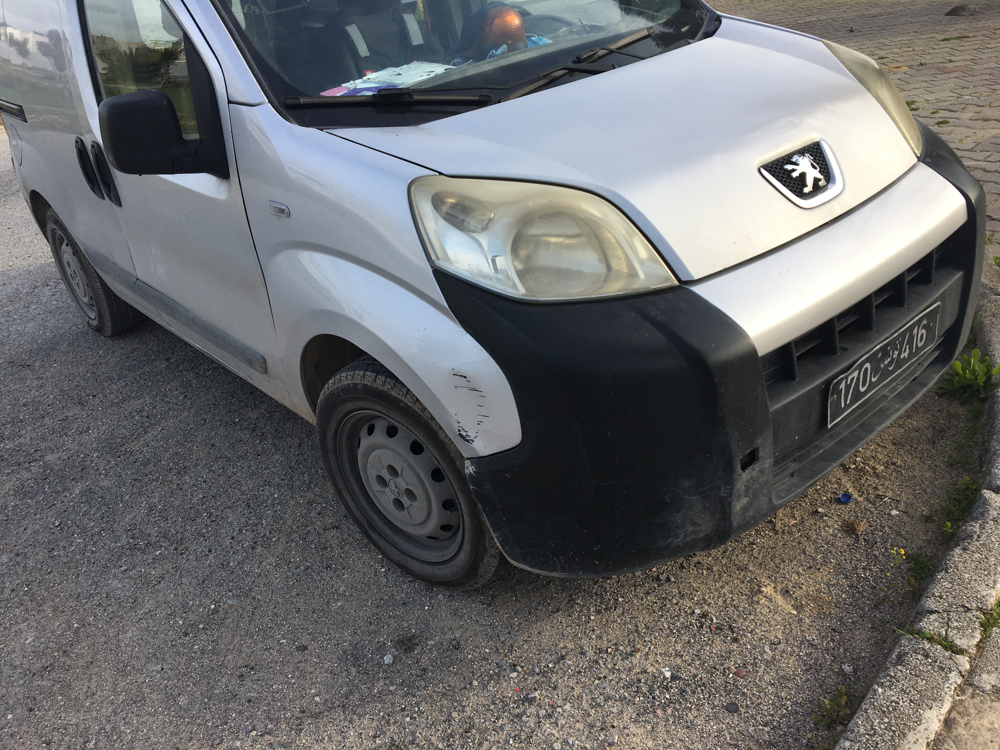

In [ ]:
sample_img

In [ ]:
sample_img_array = image.img_to_array(sample_img)

In [ ]:
sample_img_array = sample_img_array.reshape((1,) + sample_img_array.shape)

In [ ]:
samples = []
for arr,val in zip(augmentation.flow(sample_img_array, batch_size=1, save_format='jpg'),range(1)):
    img_save = image.array_to_img(arr[0], scale=False) #scale=False did the trick
    samples.append(img_save)

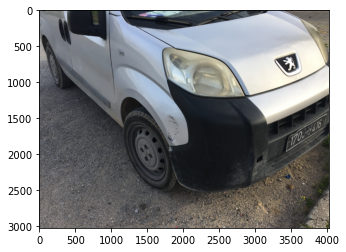

In [ ]:
plt.imshow(samples[0])

Géneration des données

In [ ]:
train_save_path_1 = paths[2][0]
train_save_path_2 = paths[2][1]
train_save_path_3 = paths[2][2]
test_save_path_1 = paths[3][0]
test_save_path_2 = paths[3][1]
test_save_path_3 = paths[3][2]
print(train_save_path_1)
print(train_save_path_2)
print(train_save_path_3)
print(test_save_path_1)
print(test_save_path_2)
print(test_save_path_3)

data_augmentation_2/data_2/train/front
data_augmentation_2/data_2/train/rear
data_augmentation_2/data_2/train/side
data_augmentation_2/data_2/test/front
data_augmentation_2/data_2/test/rear
data_augmentation_2/data_2/test/side


In [ ]:
for i in tqdm(train_front):
    create_images(i,train_save_path_1,'/content/drive/MyDrive/data_f/data2a/training/00-front')

100%|██████████| 471/471 [02:43<00:00,  2.88it/s]


In [ ]:
for i in tqdm(train_rear):
    create_images(i,train_save_path_2,'/content/drive/MyDrive/data_f/data2a/training/01-rear')

100%|██████████| 464/464 [07:43<00:00,  1.00it/s]


In [ ]:
for i in tqdm(train_side):
    create_images(i,train_save_path_3,'/content/drive/MyDrive/data_f/data2a/training/02-side')

100%|██████████| 468/468 [10:04<00:00,  1.29s/it]


In [ ]:
for i in tqdm(test_front):
    save_images(i,test_save_path_1,'/content/drive/MyDrive/data_f/data2a/validation/00-front')

100%|██████████| 73/73 [00:00<00:00, 162.47it/s]


In [ ]:
for i in tqdm(test_rear):
    save_images(i,test_save_path_2,'/content/drive/MyDrive/data_f/data2a/validation/01-rear')

100%|██████████| 58/58 [00:00<00:00, 168.04it/s]


In [ ]:
for i in tqdm(test_side):
    save_images(i,test_save_path_3,'/content/drive/MyDrive/data_f/data2a/validation/02-side')

100%|██████████| 48/48 [00:00<00:00, 183.15it/s]


# Data Bloc 3 

In [ ]:
#Getting a sample file name from list of file names
sample_file = random.choice(train_severe)

In [ ]:
#Getting a random rotation between -20 and 20
rotation = random.randint(-20,20)

In [ ]:
augmentation = ImageDataGenerator(rotation_range=rotation, shear_range = 0.2, zoom_range = 0.2, horizontal_flip=True)

In [ ]:
sample_img = image.load_img('/content/drive/MyDrive/data_f/data3a/training/03-severe'+'/'+sample_file)

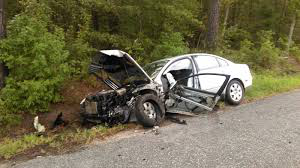

In [ ]:
sample_img

In [ ]:
sample_img_array = image.img_to_array(sample_img)

In [ ]:
sample_img_array = sample_img_array.reshape((1,) + sample_img_array.shape)

In [ ]:
samples = []
for arr,val in zip(augmentation.flow(sample_img_array, batch_size=1, save_format='jpg'),range(1)):
    img_save = image.array_to_img(arr[0], scale=False) #scale=False did the trick
    samples.append(img_save)

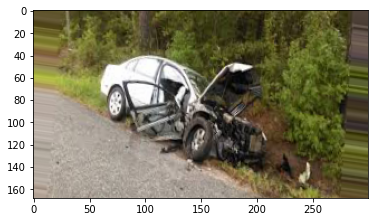

In [ ]:
plt.imshow(samples[0])

Géneration des images

In [ ]:
train_save_path_1 = paths[4][0]
train_save_path_2 = paths[4][1]
train_save_path_3 = paths[4][2]
test_save_path_1 = paths[5][0]
test_save_path_2 = paths[5][1]
test_save_path_3 = paths[5][2]
print(train_save_path_1)
print(train_save_path_2)
print(train_save_path_3)
print(test_save_path_1)
print(test_save_path_2)
print(test_save_path_3)

data_augmentation_2/data_3/train/minor
data_augmentation_2/data_3/train/moderate
data_augmentation_2/data_3/train/severe
data_augmentation_2/data_3/test/minor
data_augmentation_2/data_3/test/moderate
data_augmentation_2/data_3/test/severe


In [ ]:
for i in tqdm(train_minor):
    create_images(i,train_save_path_1,'/content/drive/MyDrive/data_f/data3a/training/01-minor')

100%|██████████| 388/388 [10:36<00:00,  1.64s/it]


In [ ]:
for i in tqdm(train_moderate):
    create_images(i,train_save_path_2,'/content/drive/MyDrive/data_f/data3a/training/02-moderate')

100%|██████████| 379/379 [00:33<00:00, 11.17it/s]


In [ ]:
for i in tqdm(train_severe):
    create_images(i,train_save_path_3,'/content/drive/MyDrive/data_f/data3a/training/03-severe')

100%|██████████| 386/386 [00:12<00:00, 30.51it/s]


In [ ]:
for i in tqdm(test_minor):
    save_images(i,test_save_path_1,'/content/drive/MyDrive/data_f/data3a/validation/01-minor')

100%|██████████| 48/48 [00:00<00:00, 209.92it/s]


In [ ]:
for i in tqdm(test_moderate):
    save_images(i,test_save_path_2,'/content/drive/MyDrive/data_f/data3a/validation/02-moderate')

100%|██████████| 55/55 [00:00<00:00, 194.33it/s]


In [ ]:
for i in tqdm(test_severe):
    save_images(i,test_save_path_3,'/content/drive/MyDrive/data_f/data3a/validation/03-severe')

100%|██████████| 68/68 [00:00<00:00, 193.18it/s]


# Données aprés Augmentation

In [ ]:
data_1_files = len(os.listdir('data_augmentation_2/data_1/train/damaged'))+len(os.listdir('data_augmentation_2/data_1/train/not_damaged'))

In [ ]:
print('Number of files for all classes damaged, not damaged is ',data_1_files)

Number of files for all classes damaged, not damaged is  4643


In [ ]:
data_2_files = len(os.listdir('data_augmentation_2/data_2/train/front'))+len(os.listdir('data_augmentation_2/data_2/train/rear'))+len(os.listdir('data_augmentation_2/data_2/train/side'))

In [ ]:
print('Number of files for all classes front,rear,side is ',data_2_files)

Number of files for all classes front,rear,side is  2724


In [ ]:
data_3_files = len(os.listdir('data_augmentation_2/data_3/train/minor'))+len(os.listdir('data_augmentation_2/data_3/train/moderate'))+len(os.listdir('data_augmentation_2/data_3/train/severe'))

In [ ]:
print('Number of files for all classes minor,moderate,severe is ',data_3_files)

Number of files for all classes minor,moderate,severe is  2288


# Conclusion 

---

j'ai crée 3 types des données 
data qui contients les données sans augmentations. 
data augmentation avec une technique d'augmentation ( 20,-20 ).
data augmentation avec la deuxiéme technique  (20, -20, zoom).

Et comme montre les differentes graphes de EDA, les images avec des dimensions differentes, donc j'ai choisi la dimension 256,256,3 comme une dimensions par defaut. 

In [ ]:
!ls

data  data_augmentation_1  data_augmentation_2	drive  sample_data


In [ ]:
!cp -r "/content/data_augmentation_1" /content/drive/MyDrive/

In [ ]:
!cp -r '/content/data_augmentation_2' /content/drive/MyDrive/

In [ ]:
!ls 

data  data_augmentation_1  data_augmentation_2	drive  sample_data


In [ ]:
!cp -r 'data_augmentation_1' /content/drive/MyDrive/

In [ ]:
!cp -r 'data_augmentation_2' /content/drive/MyDrive/

In [ ]:
!rsync -r --progress source_path destination_path

In [ ]:
!zip -r /content/data_augmentation_1.zip /content/data_augmentation_1

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
  adding: content/data_augmentation_1/data_1/test/not_damaged/0045.jpg (deflated 1%)
  adding: content/data_augmentation_1/data_1/test/not_damaged/0169.jpg (deflated 2%)
  adding: content/data_augmentation_1/data_1/test/not_damaged/0163.jpg (deflated 1%)
  adding: content/data_augmentation_1/data_1/test/not_damaged/0059.jpg (deflated 0%)
  adding: content/data_augmentation_1/data_1/test/not_damaged/0221.JPEG (deflated 5%)
  adding: content/data_augmentation_1/data_1/test/not_damaged/0226.JPEG (deflated 3%)
  adding: content/data_augmentation_1/data_1/test/not_damaged/0197.jpg (deflated 1%)
  adding: content/data_augmentation_1/data_1/test/not_damaged/0093.jpg (deflated 5%)
  adding: content/data_augmentation_1/data_1/test/not_damaged/0090.jpg (deflated 2%)
  adding: content/data_augmentation_1/data_1/test/not_damaged/0213.JPEG (deflated 4%)
  adding: content/data_augmentation_1/data_1/test/not_damaged/0050.jp

In [ ]:
!zip -r /content/data_augmentation_2.zip /content/data_augmentation_2

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
  adding: content/data_augmentation_2/data_1/test/not_damaged/0045.jpg (deflated 1%)
  adding: content/data_augmentation_2/data_1/test/not_damaged/0169.jpg (deflated 2%)
  adding: content/data_augmentation_2/data_1/test/not_damaged/0163.jpg (deflated 1%)
  adding: content/data_augmentation_2/data_1/test/not_damaged/0059.jpg (deflated 0%)
  adding: content/data_augmentation_2/data_1/test/not_damaged/0221.JPEG (deflated 5%)
  adding: content/data_augmentation_2/data_1/test/not_damaged/0226.JPEG (deflated 3%)
  adding: content/data_augmentation_2/data_1/test/not_damaged/0197.jpg (deflated 1%)
  adding: content/data_augmentation_2/data_1/test/not_damaged/0093.jpg (deflated 5%)
  adding: content/data_augmentation_2/data_1/test/not_damaged/0090.jpg (deflated 2%)
  adding: content/data_augmentation_2/data_1/test/not_damaged/0213.JPEG (deflated 4%)
  adding: content/data_augmentation_2/data_1/test/not_damaged/0050.jp

In [ ]:
!cp -r "/content/data_augmentation_1.zip" /content/drive/MyDrive/

In [ ]:
!cp -r "/content/data_augmentation_2.zip" /content/drive/MyDrive/